# Setup

## Install Detectron2

In [2]:
!python -m pip install pyyaml==5.1
import sys, os, distutils.core
# Note: This is a faster way to install detectron2 in Colab, but it does not include all functionalities (e.g. compiled operators).
# See https://detectron2.readthedocs.io/tutorials/install.html for full installation instructions
# !git clone 'https://github.com/facebookresearch/detectron2'
# dist = distutils.core.run_setup("./detectron2/setup.py")
# !python -m pip install {' '.join([f"'{x}'" for x in dist.install_requires])}
# sys.path.insert(0, os.path.abspath('./detectron2'))

# Properly install detectron2. (Please do not install twice in both ways)
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

Defaulting to user installation because normal site-packages is not writeable
     |████████████████████████████████| 274 kB 5.9 MB/s eta 0:00:01
  Created wheel for pyyaml: filename=PyYAML-5.1-cp38-cp38-linux_x86_64.whl size=44074 sha256=fcd41c930a264b23cdf49613f434121cd6af53d2e1ae96dd10c78e61a91f9ec0
  Stored in directory: /home/shabanza/.cache/pip/wheels/52/dd/2b/10ff8b0ac81b93946bb5fb9e6749bae2dac246506c8774e6cf
Successfully built pyyaml


ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
dask 2022.7.0 requires pyyaml>=5.3.1, but you have pyyaml 5.1 which is incompatible.
Defaulting to user installation because normal site-packages is not writeable
  Cloning https://github.com/facebookresearch/detectron2.git to /tmp/pip-req-build-gt3u6e46
  Running command git clone -q https://github.com/facebookresearch/detectron2.git /tmp/pip-req-build-gt3u6e46
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
     |████████████████████████████████| 5.5 MB 11.3 MB/s eta 0:00:01
     |████████████████████████████████| 50 kB 25.3 MB/s eta 0:00:01
     |████████████████████████████████| 79 kB 28.3 MB/s eta 0:00:01
     |████████████████████████████████| 154 kB 142.4 MB/s eta 0:00:01
     |████████████████████████████████| 1.6 MB 87.9 MB/s et

In [1]:
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2021 NVIDIA Corporation
Built on Mon_May__3_19:15:13_PDT_2021
Cuda compilation tools, release 11.3, V11.3.109
Build cuda_11.3.r11.3/compiler.29920130_0
torch:  1.10 ; cuda:  cu113
detectron2: 0.6


## Install Mask2Former

In [2]:
# clone and install Mask2Former
# !git clone https://github.com/facebookresearch/Mask2Former.git
%cd Mask2Former
%pip install -U opencv-python
# %pip install git+https://github.com/cocodataset/panopticapi.git
%pip install -r requirements.txt
%cd mask2former/modeling/pixel_decoder/ops
!python setup.py build install

/scratch/shabanza/segmentation/Mask2Former
Defaulting to user installation because normal site-packages is not writeable
     |████████████████████████████████| 61.7 MB 6.0 MB/s eta 0:00:01
Note: you may need to restart the kernel to use updated packages.
Defaulting to user installation because normal site-packages is not writeable


     |████████████████████████████████| 2.3 MB 6.1 MB/s eta 0:00:01
     |████████████████████████████████| 2.2 MB 120.5 MB/s eta 0:00:01
     |████████████████████████████████| 73 kB 9.5 MB/s s eta 0:00:01
     |████████████████████████████████| 1.3 MB 110.5 MB/s eta 0:00:01
     |████████████████████████████████| 268 kB 96.6 MB/s eta 0:00:01
  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.
  NOTE: The current PATH contains path(s) starting with `~`, which may not be expanded by all applications.
Note: you may need to restart the kernel to use updated packages.
/scratch/shabanza/segmentation/Mask2Former/mask2former/modeling/pixel_decoder/ops
running build
running build_py
running build_ext
building 'MultiScaleDeformableAttention' extension
Emitting ninja build file /scratch/shabanza/segmentation/Mask2Former/mask2former/modeling/pixel_decoder/ops/build/temp.linux-x86_64-3.8/build.ninja...
Compiling objects...
Allowing n

In [3]:
%cd /scratch/shabanza/segmentation/Mask2Former
%cd mask2former/modeling/pixel_decoder/ops
!sudo sh make.sh
%cd /scratch/shabanza/segmentation/Mask2Former

/scratch/shabanza/segmentation/Mask2Former
/scratch/shabanza/segmentation/Mask2Former/mask2former/modeling/pixel_decoder/ops
running build
running build_py
running build_ext
building 'MultiScaleDeformableAttention' extension
Emitting ninja build file /scratch/shabanza/segmentation/Mask2Former/mask2former/modeling/pixel_decoder/ops/build/temp.linux-x86_64-3.8/build.ninja...
Compiling objects...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
ninja: no work to do.
g++ -pthread -shared -B /opt/conda/compiler_compat -L/opt/conda/lib -Wl,-rpath=/opt/conda/lib -Wl,--no-as-needed -Wl,--sysroot=/ /scratch/shabanza/segmentation/Mask2Former/mask2former/modeling/pixel_decoder/ops/build/temp.linux-x86_64-3.8/scratch/shabanza/segmentation/Mask2Former/mask2former/modeling/pixel_decoder/ops/src/vision.o /scratch/shabanza/segmentation/Mask2Former/mask2former/modeling/pixel_decoder/ops/build/temp.linux-x86_64-3.8/scratch/shabanza/segment

Adding MultiScaleDeformableAttention 1.0 to easy-install.pth file

Installed /opt/conda/lib/python3.8/site-packages/MultiScaleDeformableAttention-1.0-py3.8-linux-x86_64.egg
Processing dependencies for MultiScaleDeformableAttention==1.0
Finished processing dependencies for MultiScaleDeformableAttention==1.0
/scratch/shabanza/segmentation/Mask2Former


For gccxx not found error:
> sudo apt-get update

> sudo apt-get install software-properties-common

> sudo add-apt-repository ppa:ubuntu-toolchain-r/test

> sudo apt-get upgrade libstdc++6

For libGL error:
> sudo apt-get install ffmpeg libsm6 libxext6  -y

## Imports

In [1]:
# import some common libraries
import os
import cv2
import json
import torch
import random
import numpy as np
import matplotlib.pyplot as plt

from PIL import Image, ImageDraw
from IPython.display import display
from IPython.display import Image as dis_image

from detectron2.utils.visualizer import Visualizer

In [2]:
torch.cuda.empty_cache()

In [3]:
# You may need to restart your runtime prior to this, to let your installation take effect
%cd Mask2Former
# Some basic setup:
# Setup detectron2 logger
from detectron2.utils.logger import setup_logger
setup_logger()
setup_logger(name="mask2former")


# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer, ColorMode
from detectron2.data import MetadataCatalog
from detectron2.projects.deeplab import add_deeplab_config
coco_metadata = MetadataCatalog.get("coco_2017_val_panoptic")

# import Mask2Former project
from mask2former import add_maskformer2_config

/scratch/shabanza/segmentation/Mask2Former


# Model

In [4]:
cfg = get_cfg()
add_deeplab_config(cfg)
add_maskformer2_config(cfg)
cfg.merge_from_file("configs/coco/instance-segmentation/swin/maskformer2_swin_large_IN21k_384_bs16_100ep.yaml")
cfg.MODEL.WEIGHTS = 'https://dl.fbaipublicfiles.com/maskformer/mask2former/coco/instance/maskformer2_swin_large_IN21k_384_bs16_100ep/model_final_e5f453.pkl'

cfg.MODEL.MASK_FORMER.TEST.SEMANTIC_ON = True
cfg.MODEL.MASK_FORMER.TEST.INSTANCE_ON = True
cfg.MODEL.MASK_FORMER.TEST.PANOPTIC_ON = True
predictor = DefaultPredictor(cfg)

/opt/conda/lib/python3.8/site-packages/torch/functional.py:445: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2157.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[08/09 11:55:23 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/maskformer/mask2former/coco/instance/maskformer2_swin_large_IN21k_384_bs16_100ep/model_final_e5f453.pkl ...
WARNING [08/09 11:55:24 mask2former.modeling.transformer_decoder.mask2former_transformer_decoder]: Weight format of MultiScaleMaskedTransformerDecoder have changed! Please upgrade your models. Applying automatic conversion now ...


# Dataset

In [5]:
sinergia_coco_dir = "/sinergia/shabanza/datasets/sinergia"
sinergia_img_dir = "/sinergia/shabanza/datasets/sinergia/images/default"
sinergia_instances_coco_path = os.path.join(sinergia_coco_dir, "coco", "annotations", "instances_default.json")

## Rquired Funcitons

In [6]:
def extract_categories(label_colors_file, categories):
    category2color = {}
    with open(label_colors_file, 'r') as f:
        lines = f.readlines()
        for line in lines:
            line = line.strip().split()
            color = list(map(int, line[:3]))
            category2color[' '.join(line[3:])] = color

    class_id2color = {}
    int2category = {}
    for category in categories:
        int2category[category['id']] = category['name']
        class_id2color[category['id']] = category2color[category['name']]
    
    return class_id2color, int2category

In [8]:
f = open(sinergia_instances_coco_path, 'r')
sinergia_instances = json.load(f)
f.close()

In [9]:
class_id2color, int2category = extract_categories(
    '/sinergia/shabanza/datasets/sinergia/label_colors.txt',
    sinergia_instances['categories']
)
class_id2color, int2category

({1: [57, 51, 58],
  2: [184, 61, 245],
  3: [204, 51, 102],
  4: [204, 153, 51],
  5: [250, 250, 55],
  6: [159, 165, 161],
  7: [0, 0, 255],
  8: [170, 240, 209],
  9: [240, 120, 240],
  10: [73, 144, 180],
  11: [204, 153, 51],
  12: [34, 127, 69],
  13: [190, 178, 146],
  14: [155, 121, 22],
  15: [253, 218, 113],
  16: [255, 204, 51],
  17: [50, 183, 250],
  18: [102, 255, 102],
  19: [184, 61, 245],
  20: [51, 221, 255],
  21: [145, 160, 70],
  22: [13, 44, 25],
  23: [18, 240, 101],
  24: [210, 212, 134],
  25: [52, 209, 183],
  26: [36, 179, 83],
  27: [178, 80, 80],
  28: [255, 204, 51]},
 {1: 'Generic Object',
  2: 'Car',
  3: 'Bus',
  4: 'Bicycle',
  5: 'Motorbike',
  6: 'Airplane',
  7: 'Boat',
  8: 'Train',
  9: 'Chair',
  10: 'Sofa',
  11: 'Table',
  12: 'Plant',
  13: 'Cat',
  14: 'Dog',
  15: 'Cow',
  16: 'Horse',
  17: 'Sheep',
  18: 'Bird',
  19: 'Generic Animal',
  20: 'Building',
  21: 'Background',
  22: 'Face',
  23: 'Hand',
  24: 'Horizon',
  25: 'Panel',
  26: '

## (Run once) Add colors to the COCO instances format

In [ ]:
# update sinergia instances

for category in sinergia_instances['categories']:
    category['color'] = class_id2color[category['id']]

## (Run once) Add segmentation to samples with bbox

In [29]:
from tqdm import tqdm

for ann in tqdm(sinergia_instances['annotations']):
    if 'segmentation' not in ann or len(ann['segmentation']) == 0:
        x, y, w, h = ann['bbox']
        ann['segmentation'] = [[x, y, x+w, y+h]]

100%|██████████| 47256/47256 [00:00<00:00, 1375647.41it/s]


In [31]:
f = open(sinergia_instances_coco_path, 'w')
json.dump(sinergia_instances, f)
f.close()

## Register Dataset

> 'Background' and 'Sheep' is missing

In [10]:
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.data.datasets.coco import load_coco_json

In [11]:
dataset_name = "sinergia_coco_instances"

In [12]:
def sinergia_dataset_function():
    return load_coco_json(
        sinergia_instances_coco_path, sinergia_img_dir, dataset_name
    )

DatasetCatalog.register(dataset_name, sinergia_dataset_function)

In [13]:
metadata = MetadataCatalog.get(dataset_name)
metadata

namespace(name='sinergia_coco_instances')

In [14]:
dataset_dicts = DatasetCatalog.get(dataset_name)
metadata = MetadataCatalog.get(dataset_name)

[08/09 11:56:27 d2.data.datasets.coco]: Loading /sinergia/shabanza/datasets/sinergia/coco/annotations/instances_default.json takes 1.39 seconds.
[08/09 11:56:27 d2.data.datasets.coco]: Loaded 282 images in COCO format from /sinergia/shabanza/datasets/sinergia/coco/annotations/instances_default.json
WARNING [08/09 11:56:27 d2.data.datasets.coco]: Filtered out 4958 instances without valid segmentation. There might be issues in your dataset generation process.  Please check https://detectron2.readthedocs.io/en/latest/tutorials/datasets.html carefully


## Visualize Samples

In [13]:
sample = random.choice(dataset_dicts)
image = cv2.imread(sample["file_name"])

In [14]:
from detectron2.utils.visualizer import Visualizer

def visualize_sample_anns(image, category_id=None):
    annotations = sample["annotations"]

    # Draw the annotations on the image
    if category_id is not None:
        annotations = filter(lambda x: x['category_id'] == category_id, annotations)
    for annotation in annotations:
        segment = annotation["segmentation"]
        if not isinstance(segment, dict):
            polygons = [segment[0]]
            for polygon in polygons:
                polygon = [(x, y) for x, y in zip(polygon[0::2], polygon[1::2])]
                polygon = [tuple(map(int, point)) for point in polygon]
                draw = ImageDraw.Draw(image)
                draw.polygon(polygon, outline='green', width=2)

    # Display the image
    image.show()

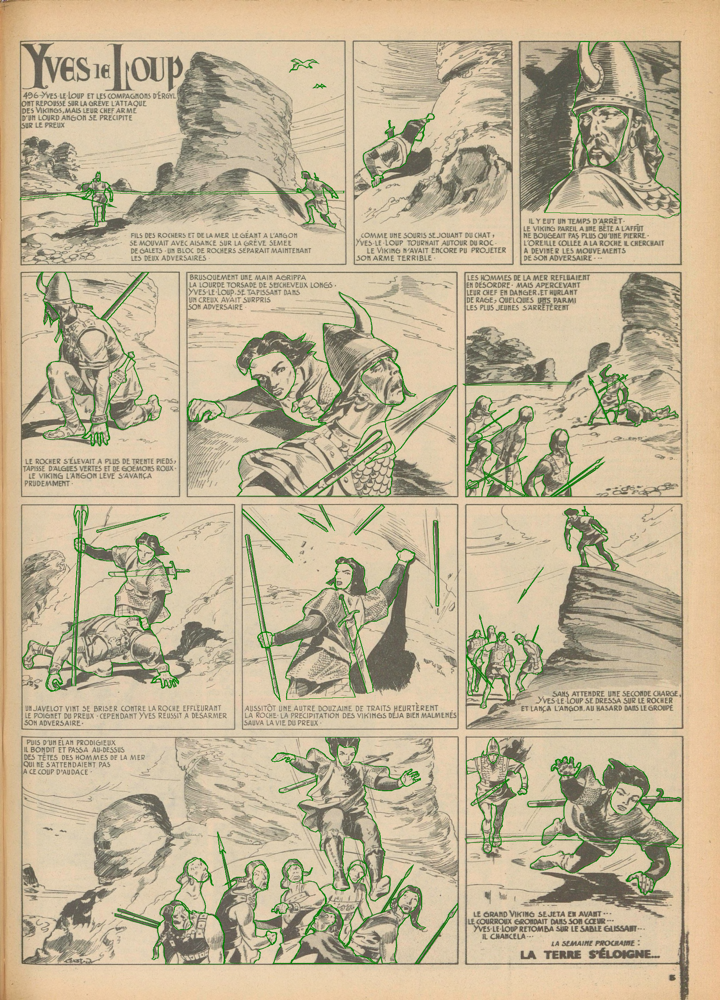

In [15]:
image = Image.open(sample["file_name"])
visualize_sample_anns(image)

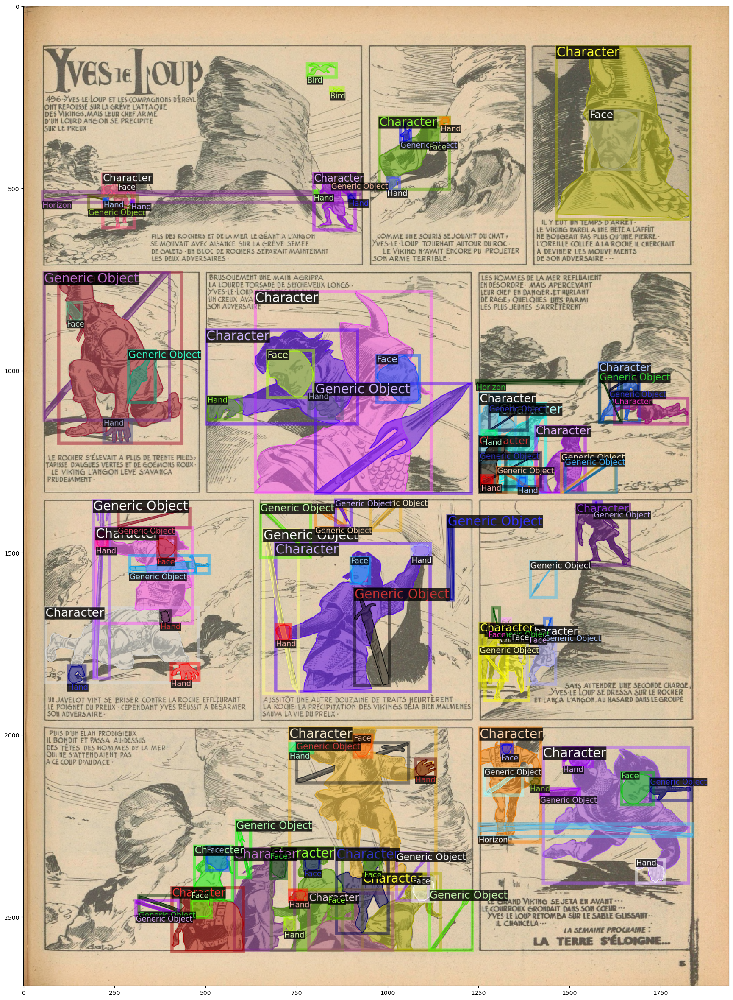

In [16]:
im = cv2.imread(sample["file_name"])
v = Visualizer(im[:, :, ::-1], metadata, scale=1.2, instance_mode=ColorMode.IMAGE_BW)
r = v.draw_dataset_dict(sample).get_image()
plt.figure(figsize=(30,30))
plt.imshow(r)

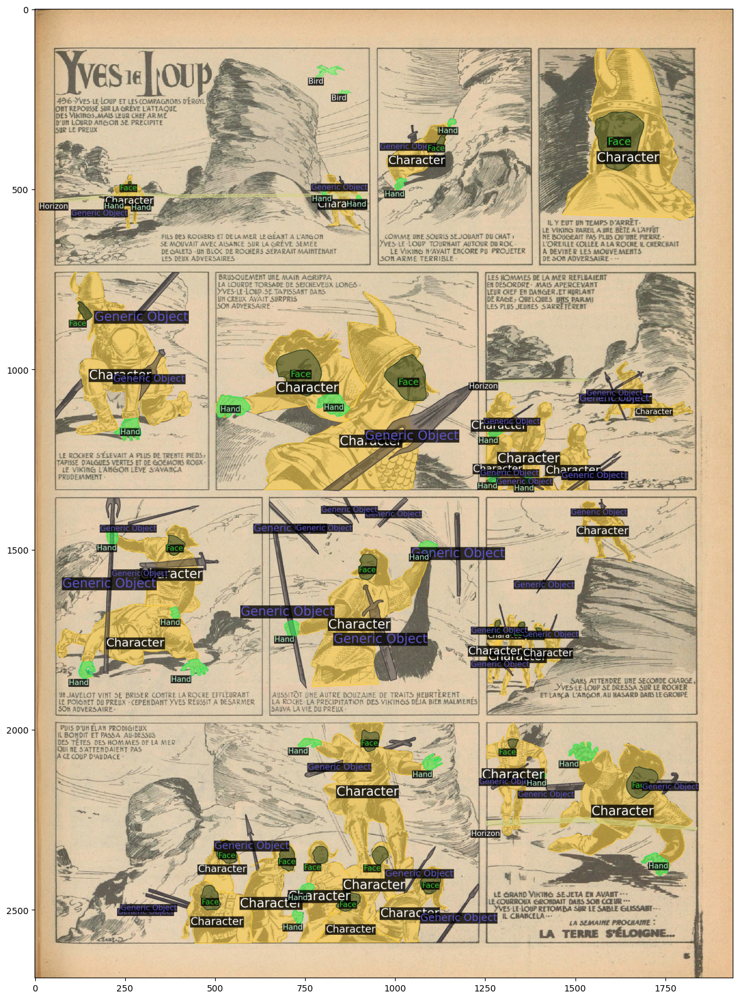

In [22]:
colors = [[x / 255 for x in class_id2color[ann['category_id'] + 1]] for ann in sample['annotations']] 
im = cv2.imread(sample["file_name"])
v = Visualizer(im[:, :, ::-1], metadata, scale=1.2, instance_mode=ColorMode.IMAGE_BW)
instance_result = v.overlay_instances(
    masks=[ann["segmentation"] for ann in sample["annotations"]],
    # boxes=[ann["bbox"] for ann in sample["annotations"]],
    labels=[int2category[ann["category_id"] + 1] for ann in sample["annotations"]],
    assigned_colors=colors,
    alpha=0.5
).get_image()
plt.figure(figsize=(20, 20))
plt.imshow(instance_result)
plt.show()

## Visualize Model Outputs

In [23]:
print(coco_metadata)
print(metadata)

Metadata(evaluator_type='coco_panoptic_seg', ignore_label=255, image_root='datasets/coco/val2017', json_file='datasets/coco/annotations/instances_val2017.json', label_divisor=1000, name='coco_2017_val_panoptic', panoptic_json='datasets/coco/annotations/panoptic_val2017.json', panoptic_root='datasets/coco/panoptic_val2017', stuff_classes=['person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus', 'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'stop sign', 'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse', 'sheep', 'cow', 'elephant', 'bear', 'zebra', 'giraffe', 'backpack', 'umbrella', 'handbag', 'tie', 'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball', 'kite', 'baseball bat', 'baseball glove', 'skateboard', 'surfboard', 'tennis racket', 'bottle', 'wine glass', 'cup', 'fork', 'knife', 'spoon', 'bowl', 'banana', 'apple', 'sandwich', 'orange', 'broccoli', 'carrot', 'hot dog', 'pizza', 'donut', 'cake', 'chair', 'couch', 'potted plant', 'bed', 'dining table', 'toil

In [24]:
# Show panoptic/instance/semantic predictions

def show_seg_predictions(im, outputs, metadata):
    v = Visualizer(im[:, :, ::-1], metadata, scale=1.2, instance_mode=ColorMode.IMAGE_BW)
    panoptic_result = v.draw_panoptic_seg(outputs["panoptic_seg"][0].to("cpu"), outputs["panoptic_seg"][1]).get_image()
    v = Visualizer(im[:, :, ::-1], metadata, scale=1.2, instance_mode=ColorMode.IMAGE_BW)
    instance_result = v.draw_instance_predictions(outputs["instances"].to("cpu")).get_image()
    v = Visualizer(im[:, :, ::-1], metadata, scale=1.2, instance_mode=ColorMode.IMAGE_BW)
    semantic_result = v.draw_sem_seg(outputs["sem_seg"].argmax(0).to("cpu")).get_image()
    print("Panoptic segmentation (top), instance segmentation (middle), semantic segmentation (bottom)")
    res = np.concatenate((panoptic_result, instance_result, semantic_result), axis=0)[:, :, ::-1]
    plt.figure(figsize=(40, 30))
    plt.imshow(res)
    plt.axis('off')
    plt.show()

/scratch/shabanza/segmentation/Mask2Former/mask2former/modeling/transformer_decoder/position_encoding.py:41: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  dim_t = self.temperature ** (2 * (dim_t // 2) / self.num_pos_feats)
/scratch/shabanza/segmentation/Mask2Former/mask2former/modeling/transformer_decoder/position_encoding.py:41: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use 

Panoptic segmentation (top), instance segmentation (middle), semantic segmentation (bottom)


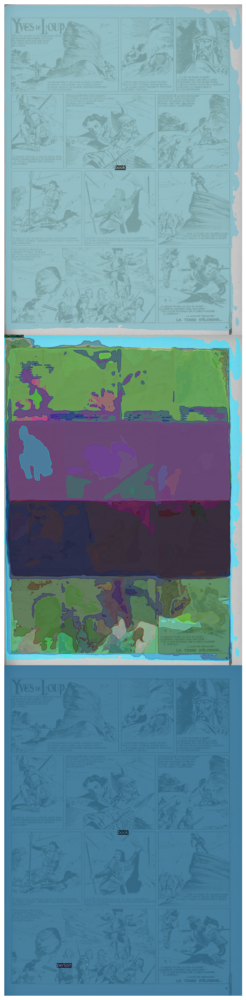

In [25]:
im = cv2.imread(sample["file_name"])
outputs = predictor(im)
show_seg_predictions(im, outputs, coco_metadata)

## Test with Panel Extracted

In [58]:
def extract_panel(image, segmentation):
    mask = np.zeros_like(image[:, :, 0])
    segments = [np.array(segment).reshape((-1, 2)).astype(np.int32) for segment in segmentation]
    cv2.fillPoly(mask, segments, 255)
    panel = cv2.bitwise_and(image, image, mask=mask)
    return panel


def get_panels(sample):
    panels = []
    cropped_boxes = []
    for ann in sample['annotations']:
        if int2category[ann['category_id'] + 1] == 'Panel':
            pil_im = Image.open(sample['file_name'])
            x, y, w, h = ann['bbox']
            cropped_image = np.array(pil_im.crop((x, y, x + w, y + h)))
            panels.append(cropped_image)
            cropped_boxes.append((x, y, x + w, y + h))
    return panels, cropped_boxes

In [27]:
im = cv2.imread(sample["file_name"])
panels, _ = get_panels(sample)


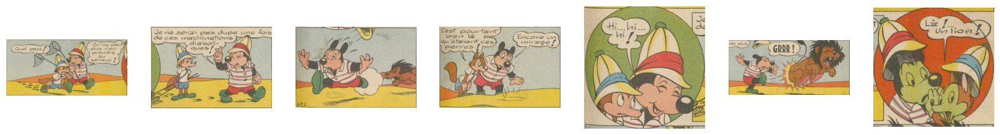

In [119]:
fig, axes = plt.subplots(1, len(panels), figsize=(20, 10))
for i, panel in enumerate(panels):
    axes[i].imshow(panel)
    axes[i].axis('off')

plt.show()

/scratch/shabanza/segmentation/Mask2Former/mask2former/modeling/transformer_decoder/position_encoding.py:41: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  dim_t = self.temperature ** (2 * (dim_t // 2) / self.num_pos_feats)
/scratch/shabanza/segmentation/Mask2Former/mask2former/modeling/transformer_decoder/position_encoding.py:41: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use 

Panoptic segmentation (top), instance segmentation (middle), semantic segmentation (bottom)


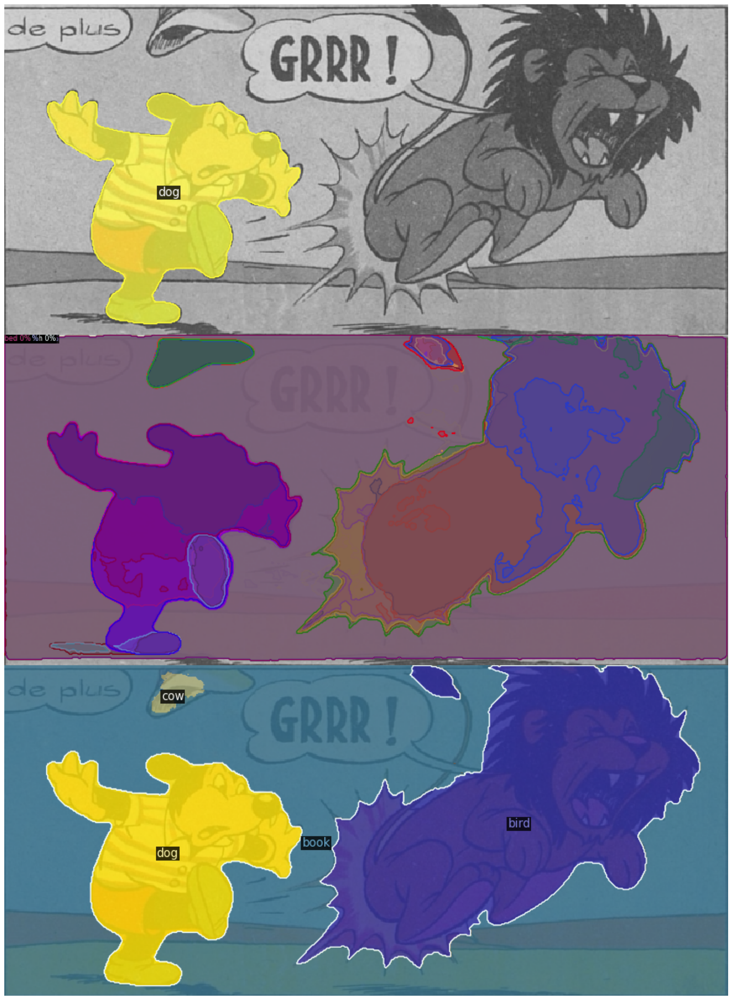

In [129]:
# Show panoptic/instance/semantic predictions

show_seg_predictions(panels[5], predictor(panels[5]), coco_metadata)

## COCO2Comic

In [16]:
sinergia_specific_classes = [
    'Building', 'Background', 'Face', 'Hand', 'Horizon', 'Panel',
    'Comic Bubble', 'Text', 'Plant'
]

comic2coco = {
    'Character': ['person'],
    'Car': ['car', 'truck'],
    'Motorbike': ['motorcycle'],
    'Bus': ['bus'],
    'Airplane': ['airplane'],
    'Bicycle': ['bicycle'],
    'Boat': ['boat'],
    'Train': ['train'],
    'Cat': ['cat'],
    'Dog': ['dog'], 
    'Cow': ['cow'], 
    'Horse': ['horse'],
    'Sheep': ['sheep'],
    'Bird': ['bird'],
    'Chair': ['chair', 'bench'],
    'Sofa': ['couch'],
    'Table': ['dining table'],
    'Generic Animal': ['elephant', 'bear', 'zebra', 'giraffe'],
    'Generic Object': [
        'traffic light', 'fire hydrant', 'stop sign', 'parking meter',
        'backpack', 'umbrella', 'handbag', 'tie', 'suitcase', 'frisbee',
        'skis', 'snowboard', 'sports ball', 'kite', 'baseball bat', 'baseball glove',
        'skateboard', 'surfboard', 'tennis racket', 'bottle', 'wine glass', 'cup', 'fork',
        'knife', 'spoon', 'bowl', 'banana', 'apple', 'sandwich', 'orange', 'broccoli',
        'carrot', 'hot dog', 'pizza', 'donut', 'cake', 'potted plant',
        'bed', 'toilet', 'tv', 'laptop', 'mouse', 'remote', 'keyboard',
        'cell phone', 'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'book',
        'clock', 'vase', 'scissors', 'teddy bear', 'hair drier', 'toothbrush'
    ]
}

for comic in sinergia_specific_classes:
    comic2coco.update({comic: []})

coco2comic = {}
for k, v in comic2coco.items():
    if isinstance(v, list):
        for item in v:
            coco2comic[item] = k

In [17]:
predicted_class_coco = 'dog'
mapped_class_custom = coco2comic[predicted_class_coco]
mapped_class_custom

'Dog'

# Evaluation

In [20]:
import numpy as np
import pycocotools.mask as mask_util
from tqdm import tqdm
from detectron2.data import DatasetCatalog, MetadataCatalog
from detectron2.evaluation import DatasetEvaluator

In [21]:
import warnings
warnings.filterwarnings('ignore')

In [63]:
category2class_id = {v: k for k, v in int2category.items()}

# Function to convert coco format segmentation to binary masks
def coco_segmentation_to_mask(segmentation, height, width):
    rle = mask_util.frPyObjects(segmentation, height, width)
    binary_mask = mask_util.decode(rle)
    binary_mask = np.any(binary_mask, axis=2).astype(np.uint8)
    return binary_mask

# Function to compute IoU between two binary masks
def compute_iou(predicted_mask, target_mask):
    intersection = np.logical_and(predicted_mask, target_mask).sum()
    union = np.logical_or(predicted_mask, target_mask).sum()
    iou = intersection / (union + 1e-6)  # Add a small epsilon to avoid division by zero
    return iou


class CustomEvaluator(DatasetEvaluator):
    def __init__(self, dataset_name):
        self.dataset_name = dataset_name
        self.metadata = MetadataCatalog.get(dataset_name)
        self.num_classes = len(self.metadata.thing_classes)
        coco_train_metadata = MetadataCatalog.get("coco_2017_train")
        self.coco_category_names = coco_train_metadata.thing_classes
        self.comic_category2class_id = {k: v - 1 for k, v in category2class_id.items()}
        self.iou_per_class = {class_id: [] for class_id in self.metadata.get("thing_classes")}
        self.reset()

    def reset(self):
        self.confusion_matrix = np.zeros((self.num_classes, self.num_classes), dtype=np.int64)

    def process(self, inputs, outputs, **kwargs):
        for input_, output in zip(inputs, outputs):
            pred_classes = output["instances"].pred_classes.cpu().numpy()
            pred_masks = output["instances"].pred_masks.cpu().numpy()
            annotations = input_["annotations"]
            height = input_["height"]
            width = input_["width"]
            image_id = input_["image_id"]

            for pred_class, pred_mask in zip(pred_classes, pred_masks):
                self._update_confusion_matrix(
                    pred_mask, pred_class, annotations, height, width, image_id, **kwargs
                )

    def _update_confusion_matrix(
        self, pred_mask, pred_class, annotations, height, width, image_id, **kwargs
    ):
        comic_pred_category = coco2comic[self.coco_category_names[pred_class]]
        pred_class = self.comic_category2class_id[comic_pred_category]
        cropped_box = kwargs.get("cropped_box", None)

        for annotation in annotations:
            category_id = annotation["category_id"]
            if category_id != pred_class:
                continue
            
            gt_mask = annotation["segmentation"]
            try:
                target_mask = coco_segmentation_to_mask(gt_mask, height, width)
            except ValueError:
                print(f"Problem in annotations image_id = {image_id} in class {comic_pred_category}!")
            
            if cropped_box is not None:
                target_mask = np.array(Image.fromarray(target_mask).crop(cropped_box))

            intersection = np.logical_and(pred_mask, target_mask).sum()
            union = np.logical_or(pred_mask, target_mask).sum()

            self.confusion_matrix[pred_class, category_id] += intersection
            self.confusion_matrix[pred_class, :] += union
            self.confusion_matrix[:, category_id] += union
    
    def _compute_iou(self):
        diagonal = np.diag(self.confusion_matrix)
        row_sum = np.sum(self.confusion_matrix, axis=1)
        col_sum = np.sum(self.confusion_matrix, axis=0)
        union = row_sum + col_sum - diagonal
        iou = np.divide(diagonal.astype(float), 
                        union.astype(float), 
                        out=np.zeros_like(diagonal, dtype=np.float64),
                        where=union != 0)
        return iou

    def evaluate(self):
        ious = self._compute_iou()
        mean_iou = np.mean(ious)

        return {
            "mean_iou": mean_iou,
            "iou_per_class": dict(enumerate(ious))
        }

In [46]:
import seaborn as sns

def plot_confusion_matrix(confusion_matrix, labels):
    plt.figure(figsize=(20, 20))
    sns.heatmap(confusion_matrix, annot=True, cmap="Blues", fmt="d", xticklabels=labels, yticklabels=labels)
    plt.xlabel("Predicted")
    plt.ylabel("Actual")
    plt.title("Confusion Matrix")
    plt.show()

### Page-Wise

In [31]:
evaluator = CustomEvaluator(dataset_name)

In [32]:
for sample in tqdm(dataset_dicts):
    im = cv2.imread(sample['file_name'])
    outputs = predictor(im)
    evaluator.process([sample], [outputs])

 95%|█████████▌| 269/282 [2:23:13<06:55, 31.94s/it]  


ValueError: invalid literal for int() with base 10: b'i^jg0g0PU2f0^O>D:G9F9H8I6J6J6I8I5L5J5L5K4K6K4L4M3L4L4L4L4L3M4M2M4M3L3M4M2M4M2N2N3L3N2N2N3L3N2M3N2N2N3M2N2N2N2N2N2M4N0O2N2N2N2N2N2N2N2N2N2O0O2N2O0O2N2N2N2O0O2N2N2N2O0O2N2O0O2O0O2N2O0O2N2O0O2O0O2O0O2O

In [38]:
def _compute_iou(self):
    diagonal = np.diag(self.confusion_matrix)
    row_sum = np.sum(self.confusion_matrix, axis=1)
    col_sum = np.sum(self.confusion_matrix, axis=0)
    union = row_sum + col_sum - diagonal
    iou = np.divide(diagonal.astype(float), union.astype(float), out=np.zeros_like(diagonal, dtype=np.float64), where=union != 0)
    return iou

In [49]:
ious = _compute_iou(evaluator)
mean_iou = np.mean(ious)

print("mean_iou", mean_iou)
print("iou_per_class:")
for class_id, iou in dict(enumerate(ious)).items():
    print(f"{int2category[class_id + 1]}: {iou}")

mean_iou 0.0024211765592786166
iou_per_class:
Generic Object: 0.03559345226002719
Car: 0.000705610502257512
Bus: 0.0
Bicycle: 3.707963079877574e-05
Motorbike: 1.8024085836975905e-06
Airplane: 0.0
Boat: 0.0006653018052469306
Train: 0.0
Chair: 0.00025475601023823205
Sofa: 4.7523897070313195e-06
Table: 0.0001697579730564392
Plant: 0.0
Cat: 9.351791265618674e-05
Dog: 0.00044706186898478225
Cow: 1.4922784906072299e-05
Horse: 0.0017359228811763558
Sheep: 0.0
Bird: 0.00011885766422557705
Generic Animal: 0.00031923331567822915
Building: 0.0
Background: 0.0
Face: 0.0
Hand: 0.0
Horizon: 0.0
Panel: 0.0
Comic Bubble: 0.0
Text: 0.0
Character: 0.027630914252258245


### Panel-Wise

In [64]:
panel_evaluator = CustomEvaluator(dataset_name)

In [68]:
for sample in tqdm(dataset_dicts):
    im = cv2.imread(sample['file_name'])
    panels, cropped_boxes = get_panels(sample)
    for panel, cropped_box in zip(panels, cropped_boxes):
        outputs = predictor(panel)
        panel_evaluator.process([sample], [outputs], cropped_box=cropped_box)

  0%|          | 0/282 [00:00<?, ?it/s]

 71%|███████▏  | 201/282 [2:48:02<1:07:43, 50.16s/it]  


KeyboardInterrupt: 

In [69]:
metrics = panel_evaluator.evaluate()
print("Mean IoU:", metrics["mean_iou"])
print("IoU per class:", metrics["iou_per_class"])

Mean IoU: 0.0028871815941371886
IoU per class: {0: 0.03556585885004751, 1: 6.336021228495028e-05, 2: 0.0, 3: 0.0, 4: 2.6448031462500165e-05, 5: 0.0005244666421526121, 6: 0.0011585465240766535, 7: 0.0, 8: 0.0003232441545786738, 9: 7.676274796987416e-05, 10: 0.000444284810624473, 11: 0.0, 12: 0.001725626929284306, 13: 0.004090158780911767, 14: 0.0, 15: 0.004537209328317648, 16: 0.0, 17: 0.0027917565795970525, 18: 0.0010244751169612753, 19: 0.0, 20: 0.0, 21: 0.0, 22: 0.0, 23: 0.0, 24: 0.0, 25: 0.0, 26: 0.0, 27: 0.028488885927571973}


In [70]:
print("mean_iou", metrics["mean_iou"])
print("iou_per_class:")
for class_id, iou in metrics["iou_per_class"].items():
    print(f"{int2category[class_id + 1]}: {iou}")

mean_iou 0.0028871815941371886
iou_per_class:
Generic Object: 0.03556585885004751
Car: 6.336021228495028e-05
Bus: 0.0
Bicycle: 0.0
Motorbike: 2.6448031462500165e-05
Airplane: 0.0005244666421526121
Boat: 0.0011585465240766535
Train: 0.0
Chair: 0.0003232441545786738
Sofa: 7.676274796987416e-05
Table: 0.000444284810624473
Plant: 0.0
Cat: 0.001725626929284306
Dog: 0.004090158780911767
Cow: 0.0
Horse: 0.004537209328317648
Sheep: 0.0
Bird: 0.0027917565795970525
Generic Animal: 0.0010244751169612753
Building: 0.0
Background: 0.0
Face: 0.0
Hand: 0.0
Horizon: 0.0
Panel: 0.0
Comic Bubble: 0.0
Text: 0.0
Character: 0.028488885927571973


### Visualize Samples

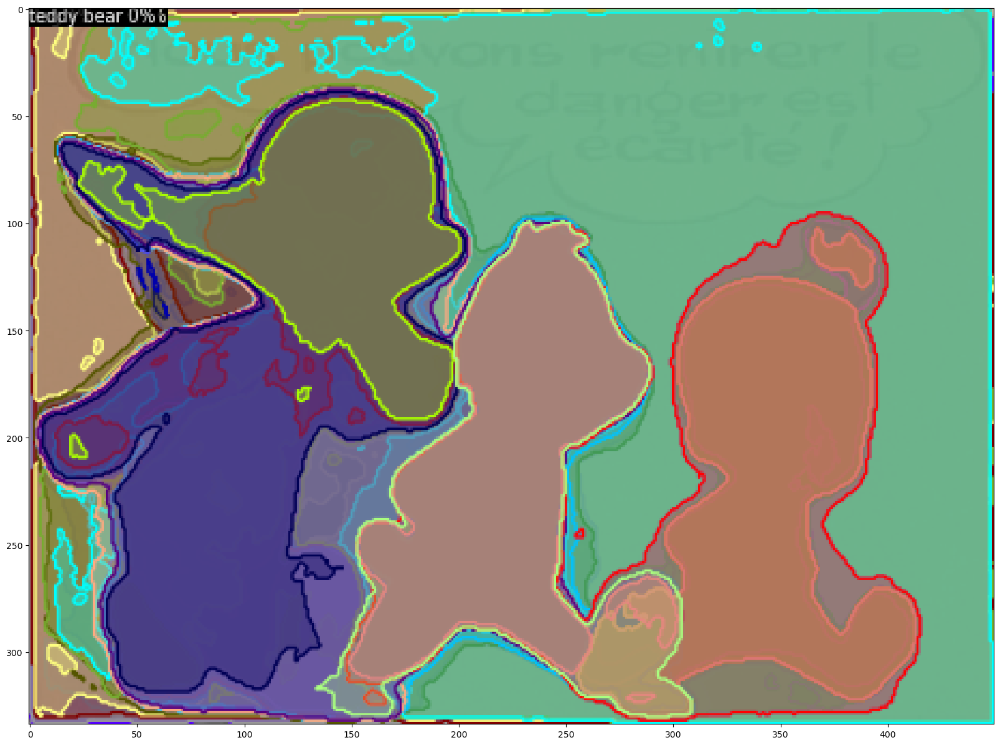

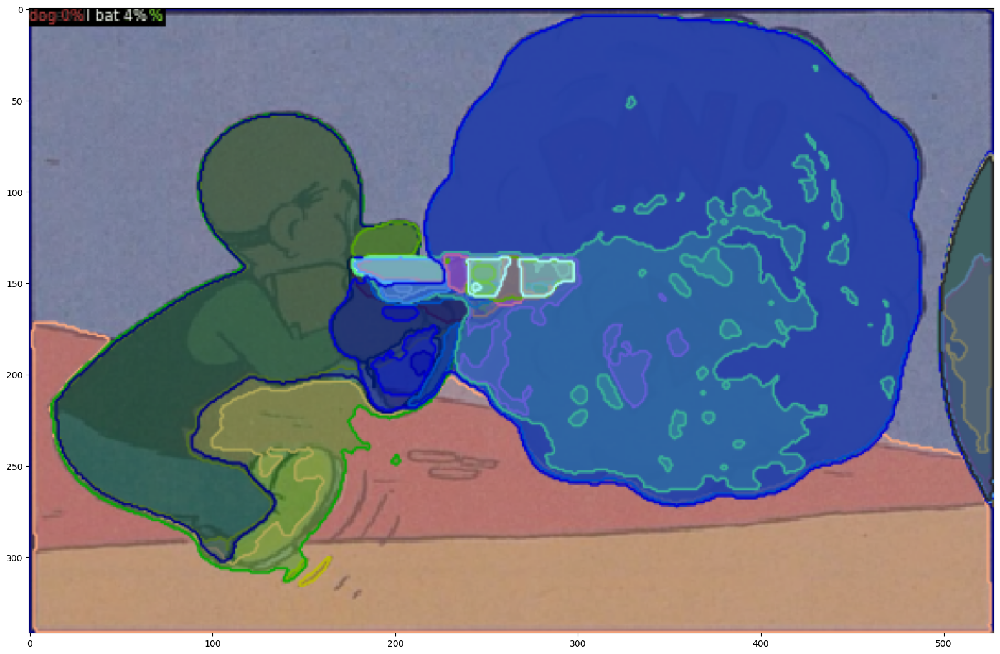

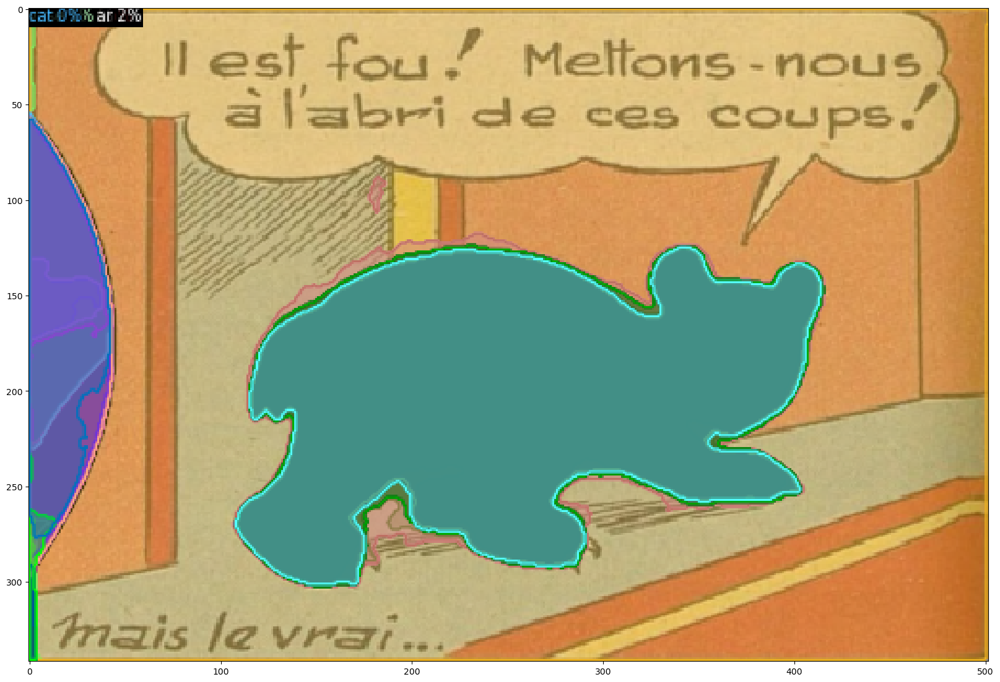

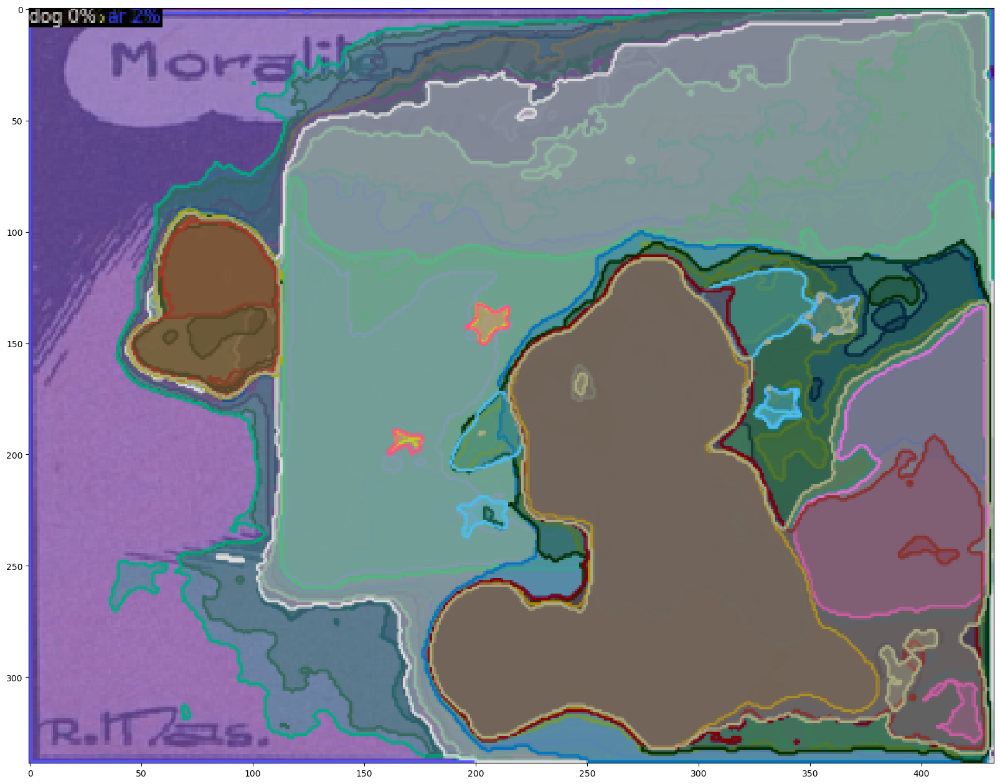

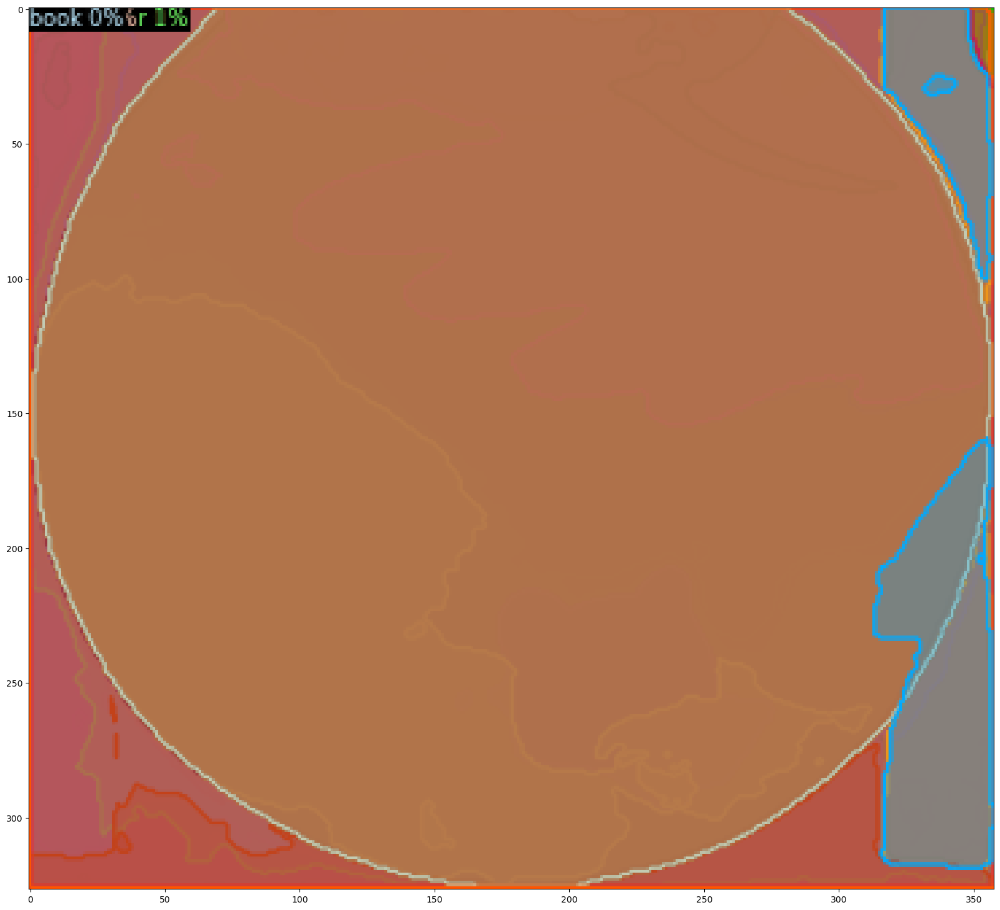

In [72]:
im = cv2.imread(sample["file_name"])
panelsو_ = get_panels(sample)
for panel in panels:
    outputs = predictor(panel)
    v = Visualizer(panel, coco_metadata, scale=1.2, instance_mode=ColorMode.IMAGE_BW)
    instance_result = v.draw_instance_predictions(outputs["instances"].to("cpu")).get_image()
    plt.figure(figsize=(20, 20))
    plt.imshow(instance_result)
    plt.show()